<a href="https://colab.research.google.com/github/mameaicha/gomycodeMAC/blob/main/SupervisedLearningRegressionCheckpointv2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Objectif : find the best model to predict a house’s price

## 1. Explore this dataset using what you have learned in data preprocessing and data visualization 

In [1]:
# Make sure that we have the latest version of pandas-profiling.
!pip install -U pandas-profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.3/352.3 kB 31.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 49.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 29.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 77.9 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=b6885e140f8b9195dad44d1aecdb6484068028a548cb07622c423f033033317d
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attemp

In [22]:
import warnings
warnings.filterwarnings('ignore')

# Standard Library Imports
from pathlib import Path


import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

from ydata_profiling import ProfileReport
from ydata_profiling.utils.cache import cache_file

from IPython.display import display

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error,r2_score 


In [3]:
# load and read dataset
file_name = cache_file(
    "kc_house_data.csv",
    "https://drive.google.com/u/0/uc?id=1Yf8pIkoJ0XG-Wz9T46wYRVobRhbOUtq8&export=download",
)

data = pd.read_csv(file_name)

In [4]:
# make a copy
df=data

### a. Analyse de forme

In [5]:
print("Taille du jeu de données :")
print(df.shape)

Taille du jeu de données :
(21613, 21)


In [6]:
print("\nVoyons à quoi ressemblent les données :")
df.head()


Voyons à quoi ressemblent les données :


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# Signification des variables:

**id**: Unique ID for each home sold 

**date**: Date of the home sale 

**price**: Price of each home sold 
 
**bedrooms**: Number of bedrooms 
 
**bathrooms**: Number of bathrooms, where .5 accounts for a room with a toilet but no shower 
 
**sqft_living**: Square footage of the apartments interior living space 

**sqft_lot**: Square footage of the land space 
 
**floors**:  Number of floors 
 
**waterfront**: A dummy variable for whether the apartment was overlooking the waterfront or not 
 
**view**:  An index from 0 to 4 of how good the view of the property was 
 
**condition**:  An index from 1 to 5 on the condition of the apartment, 
 
**grade**: An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design. 

**sqft_above**:  The square footage of the interior housing space that is above ground level 

**sqft_basement**:  The square footage of the interior housing space that is below ground level 
 
**yr_built**:  The year the house was initially built 
 
**yr_renovated**  The year of the house's last renovation 
 
**zipcode**: What zipcode area the house is in 
 
**lat**:  Lattitude 
 
**long**: Longitude 
 
**sqft_living15**:  The square footage of interior housing living space for the nearest 15 neighbors 
 
**sqft_lot15**:  The square footage of the land lots of the nearest 15 neighbors

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [8]:
df.dtypes.value_counts()

int64      15
float64     5
object      1
dtype: int64

In [9]:
# pourcentage de valeurs manquante
(df.isnull().sum() / df.shape[0])*100

id               0.0
date             0.0
price            0.0
bedrooms         0.0
bathrooms        0.0
sqft_living      0.0
sqft_lot         0.0
floors           0.0
waterfront       0.0
view             0.0
condition        0.0
grade            0.0
sqft_above       0.0
sqft_basement    0.0
yr_built         0.0
yr_renovated     0.0
zipcode          0.0
lat              0.0
long             0.0
sqft_living15    0.0
sqft_lot15       0.0
dtype: float64

<Axes: >

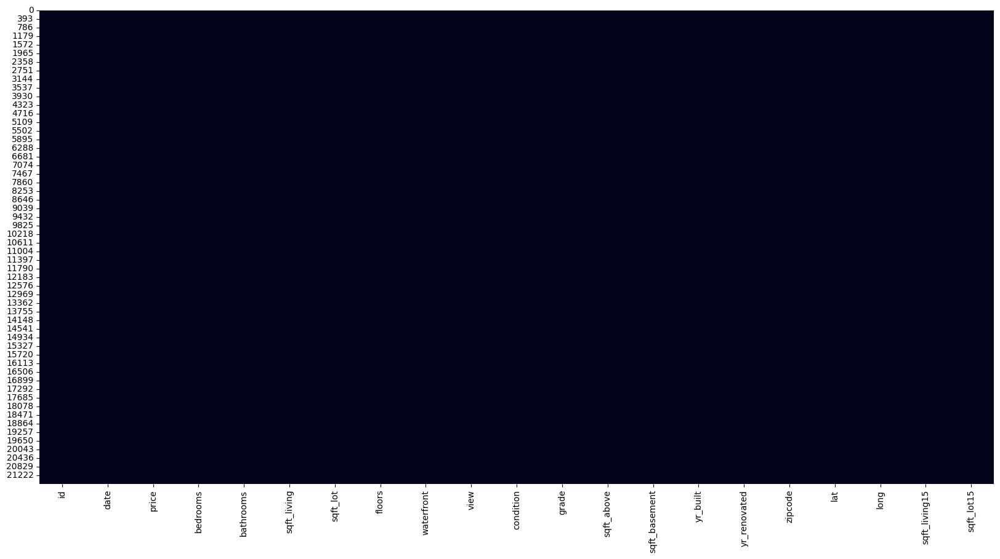

In [ ]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(),cbar=False)

l'analyse de forme, nous montre que dans ce dataset:

- il y a 21 variables dont 15 sont de type int, 5 de type float64 et 1 de type object  
-il n'y a pas de données manquantes;

### b. analyse de fond

In [ ]:
# Generate the Profiling Report
profile = ProfileReport(
    df, title="kc_house_data Dataset", html={"style": {"full_width": True}}, sort=None
)

In [ ]:
# Display the report
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 2. Write a paragraph selecting the most important features (feature selection). 

L'analyse de fond montre que:

- il n' y a pas de ligne double. Cependant l'analyse de la variable 'id' montre des lignes ayant le même id. Par consequent, on doit supprimer ces doublons car l'identifiant de chaque obervation devrait etre unique.

- il y a des outliers sur plusieurs variables

-il y a forte correlation entre les variables:

'price' et'sqft_living','bedrooms' et 'bathrooms', 'sqft_lot' et 'sqft_lot15', 'floors' et 'bathrooms', 'grade' et 'price' 'sqft_above' et 'price', 'yr_built' et 'bathrooms', zipcode et long, 'sqft_living15' et 'price','waterfront' et 'view'.

Donc à l'etat actuel 'price' est fortement correlé à 'sqft_living'; 'grade';'sqft_above' et 'sqft_living15'.

Par consequaant, ce sont ces variables qui seront considerer dans l'estimation de la la variable 'price'


### c. Data cleaning

In [10]:
#suppressions des doublons
df = df.drop_duplicates(subset=['id'])

In [11]:
df2=df[['price','sqft_living', 'grade','sqft_above','sqft_living15']]
df2

,price,sqft_living,grade,sqft_above,sqft_living15
0,221900.0,1180,7,1180,1340
1,538000.0,2570,7,2170,1690
2,180000.0,770,6,770,2720
3,604000.0,1960,7,1050,1360
4,510000.0,1680,8,1680,1800
...,...,...,...,...,...
21608,360000.0,1530,8,1530,1530
21609,400000.0,2310,8,2310,1830
21610,402101.0,1020,7,1020,1020
21611,400000.0,1600,8,1600,1410


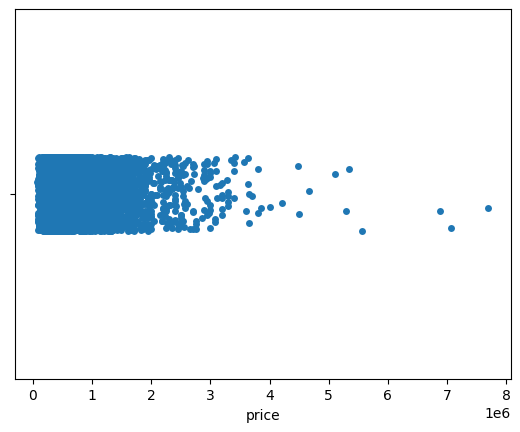

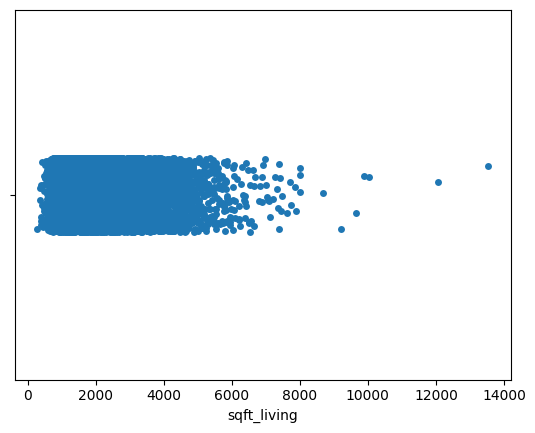

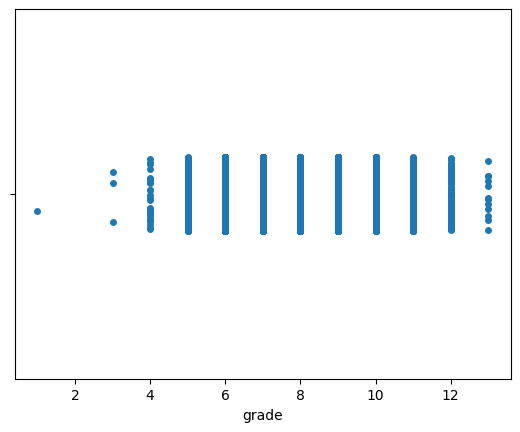

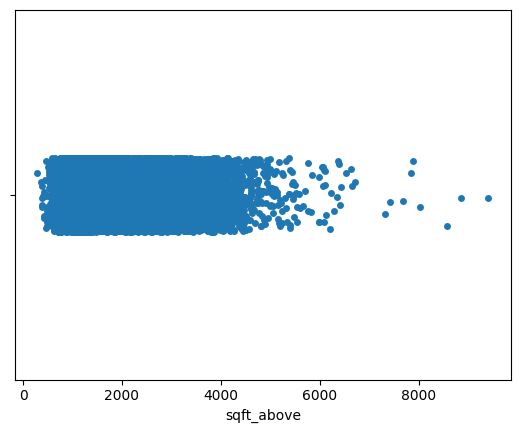

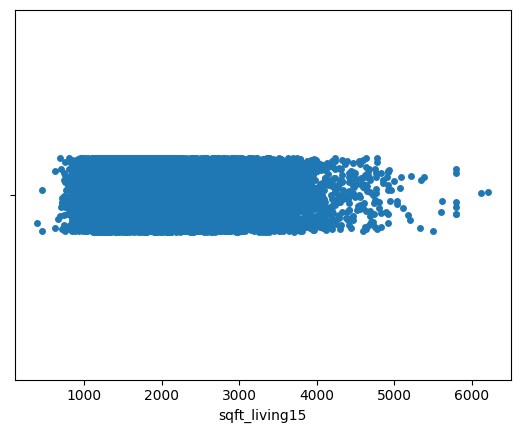

In [12]:
# outliers detection  
# represent all values on a pseudo point cloud. With striplot
for i, col in enumerate(df2.columns):
    plt.figure(i)
    sns.stripplot(x = col, data = df2, jitter = True)

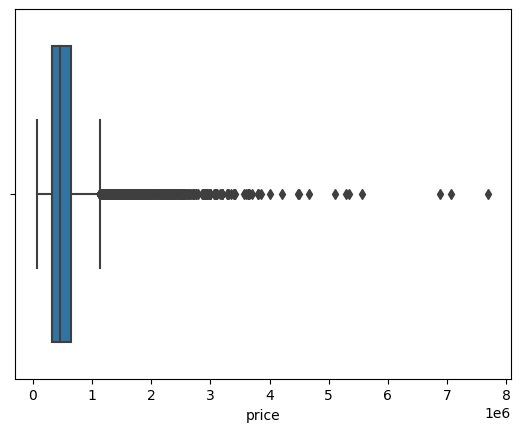

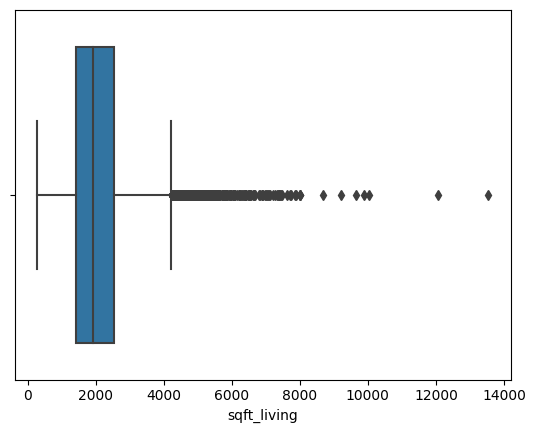

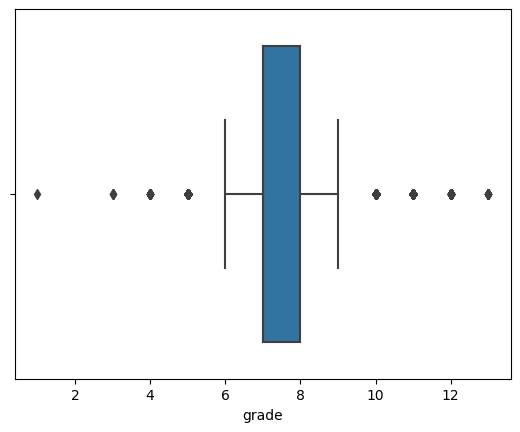

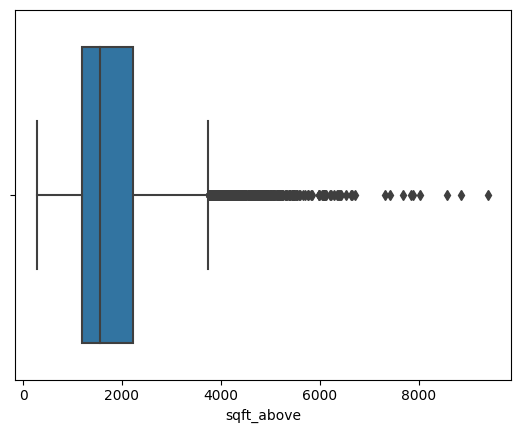

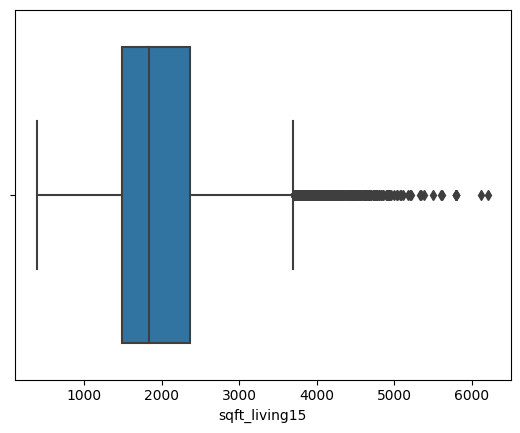

In [ ]:
for i, col in enumerate(df2.columns):
    plt.figure(i)
    sns.boxplot(x = col, data = df2)

In [13]:
#let us numerically draw conclusions
#creating function that can calculate interquartile range of the data
def calc_interquartile(data, column):
    global lower, upper
    #calculating the first and third quartile
    first_quartile, third_quartile = np.percentile(data[column], 25), np.percentile(data[column], 75)
    #calculate the interquartilerange
    iqr = third_quartile - first_quartile
    # outlier cutoff (1.5 is a generally taken as a threshold thats why i am also taking it)
    cutoff = iqr*1.5
    #calculate the lower and upper limits
    lower, upper = first_quartile - cutoff , third_quartile + cutoff
    #remove the outliers from the columns
    upper_outliers = data[data[column] > upper]
    lower_outliers = data[data[column] < lower]
    print('Lower outliers', lower_outliers.shape[0])
    print('Upper outliers', upper_outliers.shape[0])
    return print('total outliers', upper_outliers.shape[0] + lower_outliers.shape[0])


Total outliers in  price
Lower outliers 0
Upper outliers 1139
total outliers 1139
1129275.0 -162125.0


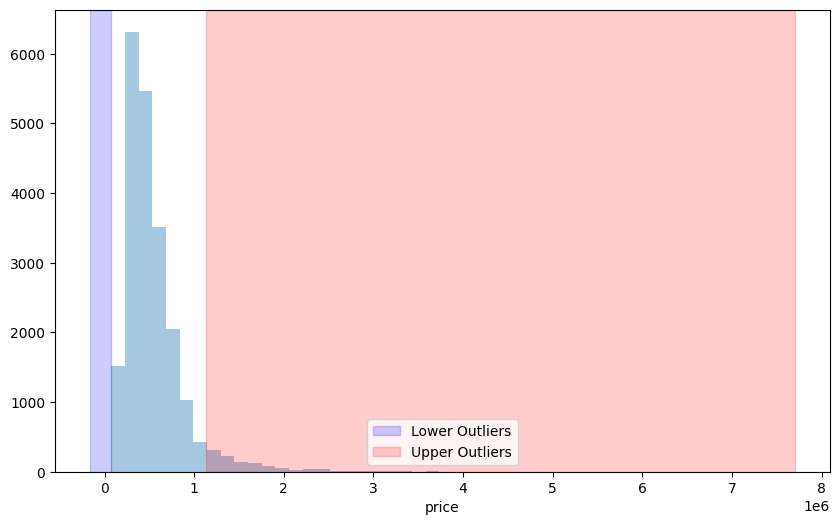

Total outliers in  sqft_living
Lower outliers 0
Upper outliers 569
total outliers 569
4230.0 -250.0


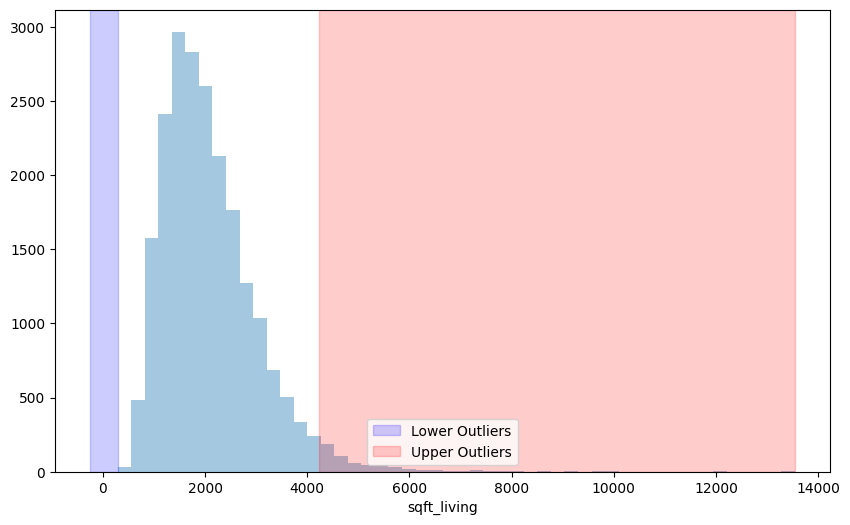

Total outliers in  grade
Lower outliers 267
Upper outliers 1628
total outliers 1895
9.5 5.5


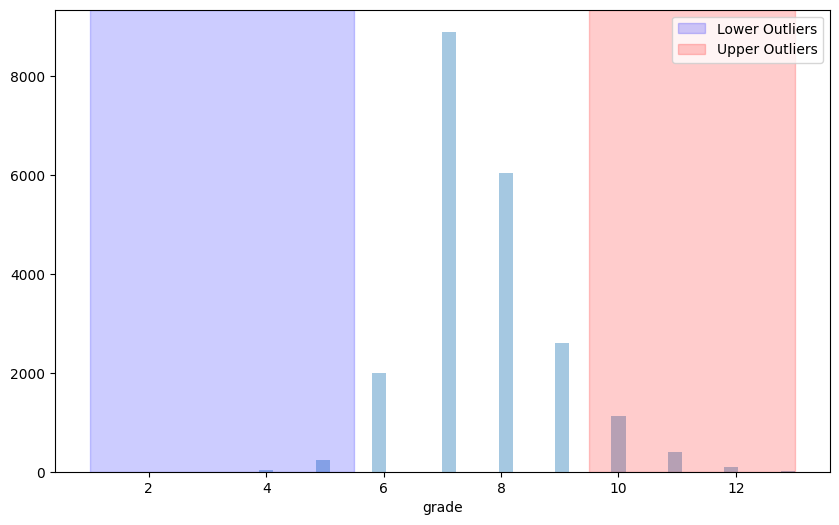

Total outliers in  sqft_above
Lower outliers 0
Upper outliers 601
total outliers 601
3750.0 -330.0


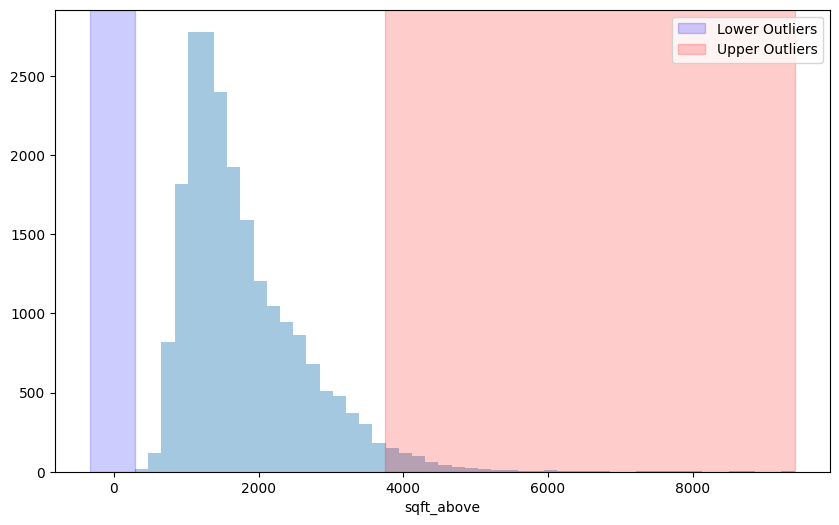

Total outliers in  sqft_living15
Lower outliers 0
Upper outliers 504
total outliers 504
3690.0 170.0


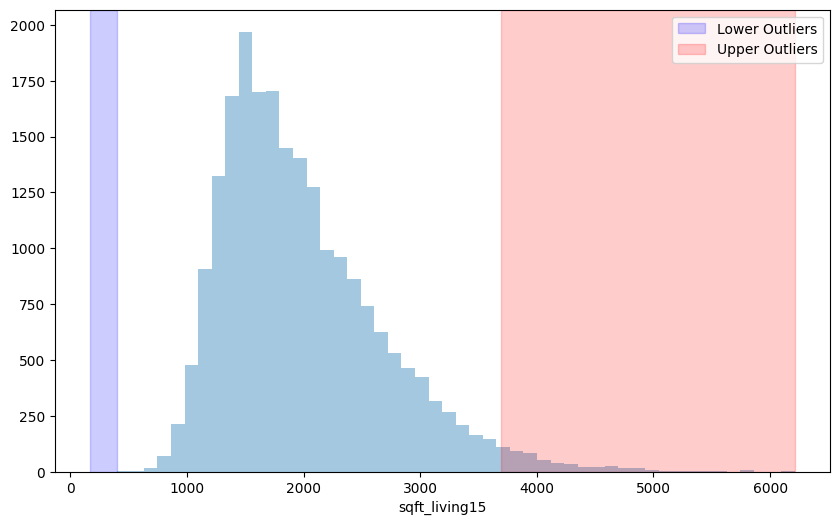

In [14]:
#plotting outliers graph for each feature 
for  col in df2.columns:
  print('Total outliers in ', col)
  calc_interquartile(df2, col)
  plt.figure(figsize = (10,6))
  sns.distplot(df2[col], kde=False)
  print(upper, lower)
  plt.axvspan(xmin = lower,xmax= df2[col].min(),alpha=0.2, color='blue', label='Lower Outliers')
  plt.axvspan(xmin = upper,xmax= df2[col].max(),alpha=0.2, color='red', label='Upper Outliers')
  plt.legend()
  plt.show()

In [15]:
#suppression oulier pour les variables
df_sansOutlier=df2
for col in df2.columns:
  #On calcule Q1
  q1=df_sansOutlier[col].quantile(q=0.25)
  #On calcule Q3
  q3=df_sansOutlier[col].quantile(q=0.75)
  #On calcule l'écart interquartile (IQR)
  IQR=q3-q1
  #On calcule la borne inférieure à l'aide du Q1 et de l'écart interquartile
  borne_inf = q1-1.5*IQR
  #On calcule la borne supérieure à l'aide du Q3 et de l'écart interquartile
  borne_sup = q3 +1.5*IQR
  #On garde les valeurs à l'intérieur de la borne inférieure et supérieure
  df_sansOutlier= df_sansOutlier[df_sansOutlier[col]<borne_sup]
  df_sansOutlier=df_sansOutlier[df_sansOutlier[col]>borne_inf]

ananlyse univarée

In [ ]:
df_sansOutlier.describe() # fait un resumé statistique du dataset(variable quantitative par defaut)

,price,sqft_living,grade,sqft_above,sqft_living15
count,1.849500e+04,18495.000000,18495.000000,18495.000000,18495.000000
mean,4.548027e+05,1867.989403,7.408921,1598.871208,1836.107651
std,1.888268e+05,634.595231,0.813079,578.793815,505.409986
min,8.200000e+04,390.000000,6.000000,390.000000,399.000000
25%,3.100000e+05,1380.000000,7.000000,1160.000000,1450.000000
50%,4.240000e+05,1800.000000,7.000000,1470.000000,1760.000000
75%,5.669750e+05,2300.000000,8.000000,1950.000000,2170.000000
max,1.127000e+06,3990.000000,9.000000,3240.000000,3280.000000


In [ ]:
# histogramme
for col in df_sansOutlier.columns:
  fig = px.histogram(data_frame = df_sansOutlier,x = col)
  fig.show()

   analyse bivariée:

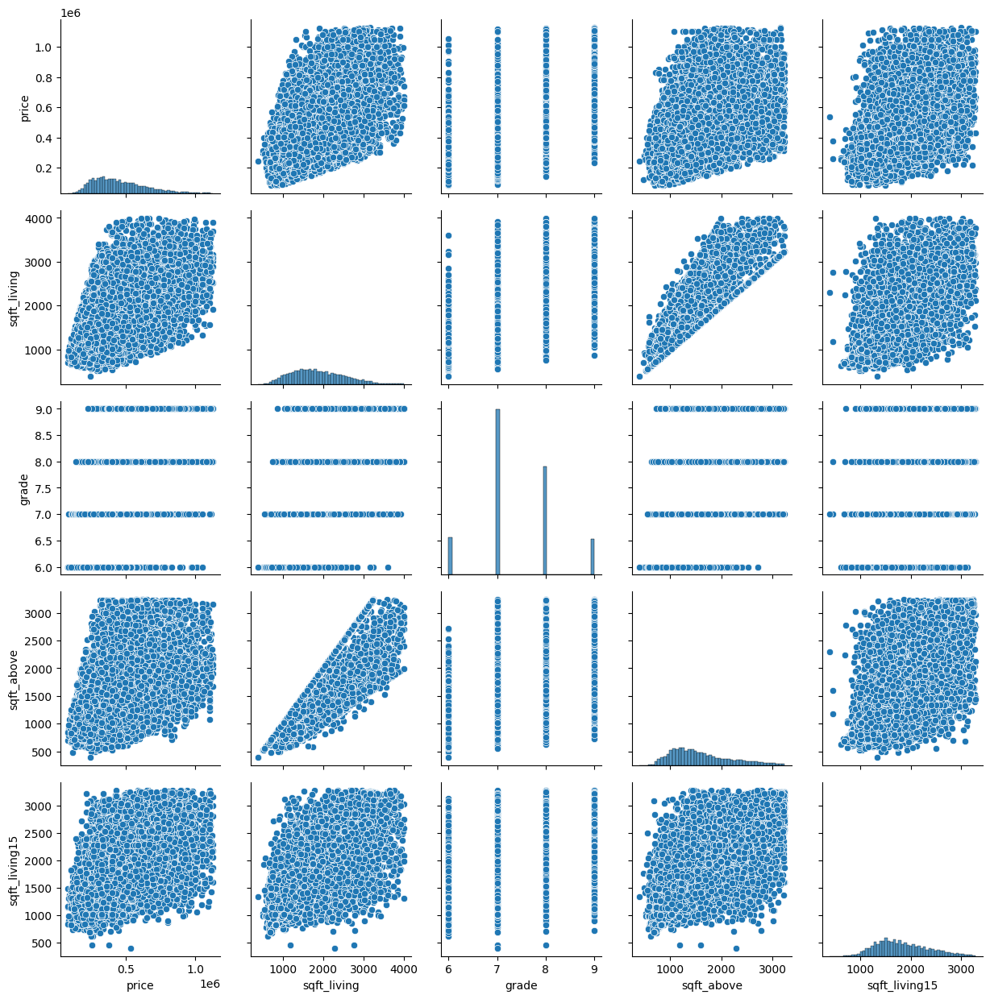

In [ ]:
# vue globale
g = sns.PairGrid(df_sansOutlier)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)


,sqft_living,price
sqft_living,1.000000,0.527188
price,0.527188,1.000000


<Figure size 1000x500 with 0 Axes>

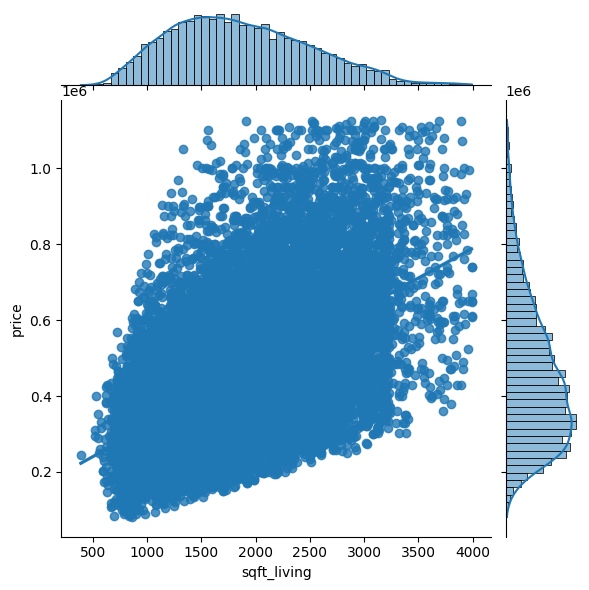

,grade,price
grade,1.000000,0.528399
price,0.528399,1.000000


<Figure size 1000x500 with 0 Axes>

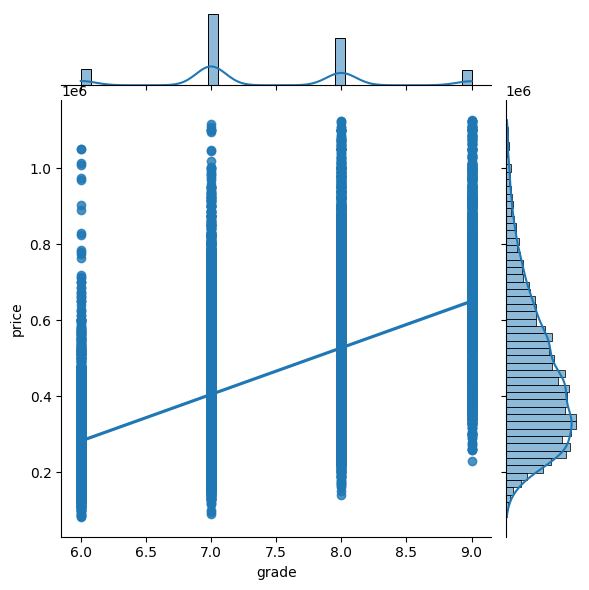

,sqft_above,price
sqft_above,1.000000,0.393387
price,0.393387,1.000000


<Figure size 1000x500 with 0 Axes>

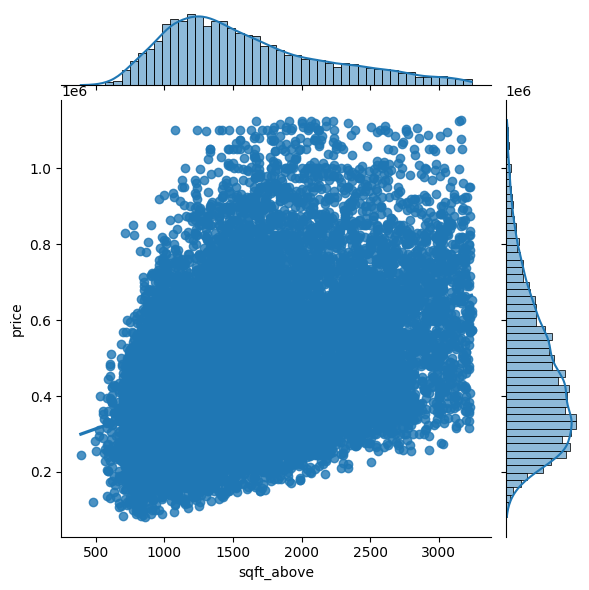

,sqft_living15,price
sqft_living15,1.000000,0.449297
price,0.449297,1.000000


<Figure size 1000x500 with 0 Axes>

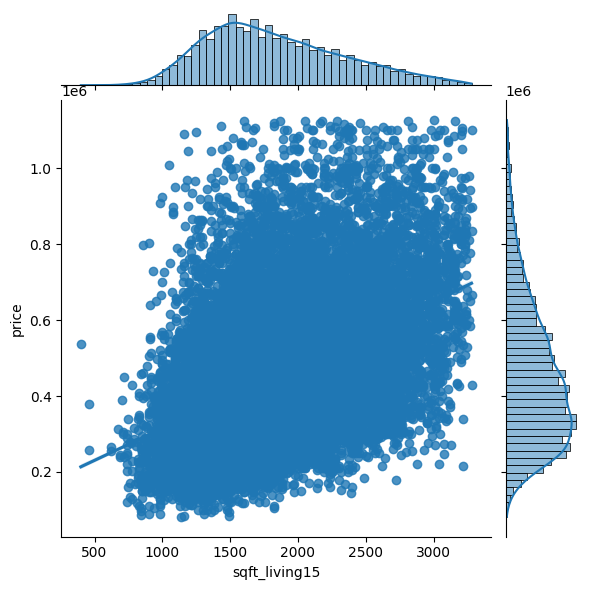

In [ ]:
# quantitative vs 'price'
for col in df_sansOutlier.drop("price",axis=1).columns:
  plt.figure(figsize=(10,5))
  sns.jointplot(x = col, y = "price", data = df_sansOutlier,kind = "reg")
  display(df_sansOutlier[[col,'price']].corr())
  plt.show()

In [16]:
#Apres ces analyses nous avons retenu:
#data preparation
X = df_sansOutlier[['sqft_living', 'grade', 'sqft_above', 'sqft_living15']].values
Y = df_sansOutlier['price'].values

# 3. Split your dataset into a training set and a testing set. 

In [18]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.35,random_state=40) #splitting data with test size of 35%

# 4. Apply Linear regression to your training set. 

In [19]:
#Training the model
model=LinearRegression()   #build linear regression model
model.fit(X_train[:,[0]],Y_train)  #fitting the training data

LinearRegression()

In [23]:
# Predictions
Y_pred=model.predict(X_test[:,[0]]) #testing our model’s performance

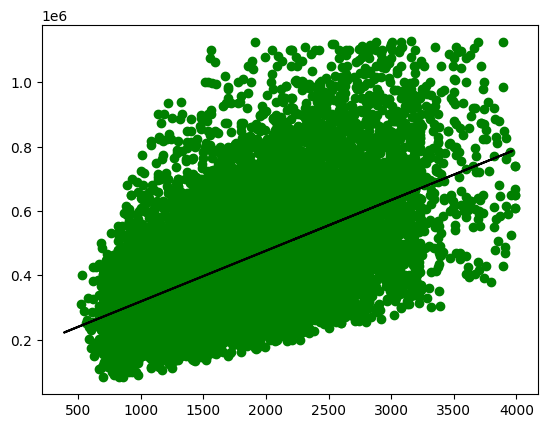

In [24]:
# Plotting regression line

plt.scatter(X_train[:,[0]],Y_train,color='g') 
plt.plot(X_test[:,[0]], Y_pred,color='k') 
plt.show()



# 6. Measure the performance of linear regression using the testing set. 

In [28]:

# The coefficients
print("Coefficients: \n", model.coef_)
# The mean squared error
print("Mean squared error (MSE): %.2f" % mean_squared_error(Y_test, Y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination (R squared): %.2f" % r2_score(Y_test, Y_pred))

Coefficients: 
 [157.8045512]
Mean squared error (MSE): 25765113592.38
Coefficient of determination (R squared): 0.27


# 7. Apply multi-linear regression and compare it to the linear model.

In [29]:
#Training the model
modelMulti=LinearRegression()   #build linear regression model
modelMulti.fit(X_train,Y_train)  #fitting the training data

LinearRegression()

In [30]:
# Predictions
Y_pred=modelMulti.predict(X_test) #testing our model’s performance

In [32]:
# The coefficients
print("Coefficients: \n", modelMulti.coef_)
# The mean squared error
print("Mean squared error (MSE): %.2f" % mean_squared_error(Y_test, Y_pred))
# The coefficient of determination: 1 is perfect prediction
print("Coefficient of determination (R squared): %.2f" % r2_score(Y_test, Y_pred))

Coefficients: 
 [ 1.23427725e+02  8.02874871e+04 -7.15370070e+01  4.29810814e+01]
Mean squared error (MSE): 22707104546.97
Coefficient of determination (R squared): 0.36


Conclusion: au vue des ces résultats, nous pouvons affirmer que  le model Multilineaire est mieux que le model lineaire.Cepandant tous les deux modèles ont un "R squared" inférieur à 5.  ce qui signifie que moins de la moitié de la variation de la variable 'price' peut être expliquée par les données d'entrée du modèle.
